<a href="https://colab.research.google.com/github/Varann123/folium_project_n3ts/blob/main/Almayra_Galuh_Zavarany_X5_Kota_Batam.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Template Tugas Project

1. import folium, pandas, geopandas, dan drive.
2. load data shapefile, pilih kota/kabupaten yang akan dianalisis
3. load data csv dan proses merge/join data
4. load peta choropleth

In [37]:
# Import Library

import folium
import pandas as pd
import geopandas as gpd
from google.colab import drive

Pilih nama kota / kabupaten kalian. jika tidak muncul pastikan namanya sesuai dengan nama di link berikut :
https://geoservices.big.go.id/portal/apps/webappviewer/index.html?id=cb58db080712468cb4bfd408dbde3d70

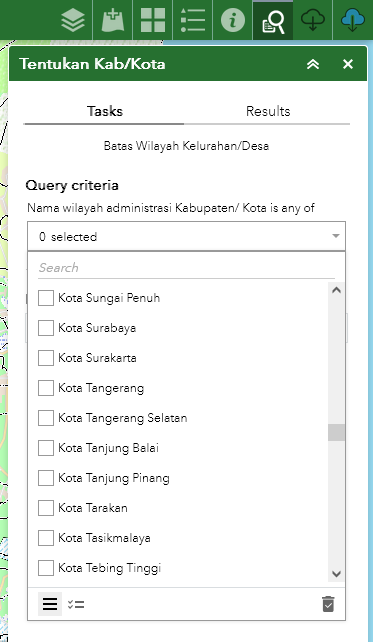

In [38]:
# Read Data Shapefile

drive.mount('/content/drive')

# Shapefile Admin Indonesia (tidak usah diubah2) Warning! File besar 1.4gb
indonesia_admin = gpd.read_file('/content/drive/MyDrive/ADMIN_INDO/ADMINISTRASI_AR_DESAKEL_10K.shp')

# Pilih Kota/Kabupaten yang ingin ditampilkan, contoh 'Kota Tangerang Selatan'
aoi_admin = indonesia_admin[indonesia_admin['WADMKK'] == 'Kota Batam']

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [39]:
# CSV file path
csv_path = '/content/drive/MyDrive/Penduduk Kota Batam Menurut Kelurahan, 2022-2023.csv'

# Read shapefile
admin_gdf = aoi_admin

# Read CSV data
csv_data = pd.read_csv(csv_path)

print(csv_data.head())
print(admin_gdf.head())
# Convert column names to lowercase
csv_data['Kelurahan'] = csv_data['Kelurahan'].str.lower().str.replace(' ', '')
admin_gdf['NAMOBJ'] = admin_gdf['NAMOBJ'].str.lower().str.replace(' ', '')
#csv_data['Jumlah_KK'] = csv_data['Jumlah_KK'].astype(str).str.replace('.', '')
#csv_data['Jumlah_KK'] = pd.to_numeric(csv_data['Jumlah_KK'])

# Fix typo to merge properly
#admin_gdf['NAMOBJ'] = admin_gdf['NAMOBJ'].str.replace('pondokjagungt', 'pondokjagung')
#csv_data['Kelurahan'] = csv_data['Kelurahan'].str.replace('perigibaru', 'parigibaru')

# Merge data
merged_data = pd.merge(admin_gdf, csv_data, left_on='NAMOBJ', right_on='Kelurahan', how='left')

# Convert to GeoDataFrame
merged_gdf = gpd.GeoDataFrame(merged_data, geometry=merged_data.geometry)

print(merged_gdf.head())
# Now you can use merged_gdf for further analysis and visualization

      Kelurahan  2022
0  Pulau Terong   533
1        Pecong  1909
2          Kasu  1829
3       Pemping   508
4  Tanjung Sari  2829
       OBJECTID        NAMOBJ       FCODE REMARK  \
42782   42783.0      Air Raja  BA03070040   None   
42808   42809.0   Baloi Indah  BA03070040   None   
42809   42810.0  Baloi Permai  BA03070040   None   
42848   42849.0    Batu Besar  BA03070040   None   
42854   42855.0   Batu Legong  BA03070040   None   

                                           METADATA     SRS_ID KDBBPS KDCBPS  \
42782  TASWIL1000020230928_DATA_BATAS_DESAKELURAHAN  SRGI 2013   None   None   
42808  TASWIL1000020230928_DATA_BATAS_DESAKELURAHAN  SRGI 2013   None   None   
42809  TASWIL1000020230928_DATA_BATAS_DESAKELURAHAN  SRGI 2013   None   None   
42848  TASWIL1000020230928_DATA_BATAS_DESAKELURAHAN  SRGI 2013   None   None   
42854  TASWIL1000020230928_DATA_BATAS_DESAKELURAHAN  SRGI 2013   None   None   

         KDCPUM KDEBPS  ...      WADMKK          WADMPR WIADKC WIADKK  WIA

/usr/local/lib/python3.10/dist-packages/geopandas/geodataframe.py:1819: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)


In [58]:
# Create a base map
m = folium.Map(location=[-6.3, 106.7], zoom_start=11)

# Ensure '2022' column in merged_gdf is numeric
merged_gdf['2022'] = pd.to_numeric(merged_gdf['2022'], errors='coerce') # errors='coerce' will replace non-numeric values with NaN

# Create a choropleth map
choropleth = folium.Choropleth(
    geo_data=merged_gdf,
    name='choropleth',
    data=merged_gdf,
    columns=["Kelurahan", "2022"],
    key_on= "feature.properties.NAMOBJ",
    fill_color='YlOrRd',
    fill_opacity=0.7,
    line_opacity=1,
    legend_name="2022"
).add_to(m)

jumlah_KK = folium.GeoJson(
    data=merged_gdf,
    name='2022',
    style_function=lambda feature: {'fillOpacity': 0, 'color': 'transparent'},
    popup = folium.GeoJsonPopup(
        fields=['WADMKD','2022'],
        aliases=['Kelurahan','2022']
    )
).add_to(choropleth)

folium.LayerControl().add_to(m)


m

In [61]:
# Create a base map
m = folium.Map(location=[0.8371521,103.7234371], zoom_start=13)

# Create a choropleth map
choropleth = folium.Choropleth(
    geo_data=merged_gdf,
    name="Jumlah KK Kelurahan Batam",
    data=merged_gdf,
    columns=["Kelurahan", "2022"],
    key_on= "feature.properties.NAMOBJ",
    fill_color='YlOrRd',
    fill_opacity=0.7,
    line_opacity=1,
    legend_name="2022"
).add_to(m)

# Create/import data sma
data_sma = pd.read_csv('sman_batam.csv')

data_sma['geometry'] = gpd.GeoSeries.from_wkt(data_sma['WKT'])

# Extract latitude and longitude from Point geometries
data_sma['latitude'] = data_sma['geometry'].apply(lambda x: x.y)
data_sma['longitude'] = data_sma['geometry'].apply(lambda x: x.x)

# Add markers to the map
# Create a marker layer
marker_layer = folium.FeatureGroup(name="SMAN Batam")

# Add markers to the layer
for i in range(0, len(data_sma)):
    folium.Marker([data_sma.iloc[i]['latitude'], data_sma.iloc[i]['longitude']], popup=data_sma.iloc[i]['nama']).add_to(marker_layer)

m.add_child(marker_layer)

# Add Jumlah_KK layer map
jumlah_KK = folium.GeoJson(
    data=merged_gdf,
    name='Jumlah_KK',
    style_function=lambda feature: {'fillOpacity': 0, 'color': 'transparent'},
    popup = folium.GeoJsonPopup(
        fields=['NAMOBJ','2022'],
        aliases=['Kelurahan','2022']
    )
).add_to(choropleth)

folium.LayerControl().add_to(m)


m

Analysis Question:
Kelurahan mana yang memiliki jumlah KK dengan kelas tertinggi (Merah Tua)?

Jawab: Kelurahan Belian

Kelurahan apa saja yang tidak terdapat Sekolah Negeri?

Jawab: Kelurahan :
Pulau Terong,
Pecong,
Kasu,
Pemping,
Tanjung Sari,
Sekanak Raya,
Pantai Gelam,
Temoyong,
Pulau Setokok,
Batu Legong,
Bulang Lintang,
Pulau Buluh,
Pulau Abang,
Karas,
Sijantung,
Sembulang,
Rempang Cate,
Subang Mas,
Galang Baru,
Air Raja,
Tanjung Piayu,
Muka Kuning,
Duriangkang,
Mangsang,
Tembesi,
Sungai Lekop,
Sungai Langkai,
Ngenang,
Kabil,
Sambau,
Taman Baloi,
Teluk Tering,
Sungai Panas,
Sukajadi,
Tiban Baru,
Tiban Lama,
Tiban Indah,
Patam Lestari,
Tanjug Pinggir,
Tanjung Uncang,
Bukit Tempayan,
Buliang,
Baloi Indah,
Batu Selicin,
Kampung Pelita,
Lubuk Baja Kota,
Tanjung Uma,
Kampung Seraya,
Sungai Jodoh,
Tanjung Sengkuang,
Batu Merah,
Bengkong Laut,
Bengkong Indah,
Tanjung Buntung,